Adapted from the [SAM2 model video predictor example notebook][notebook] provided by the authors.

[notebook]: https://github.com/facebookresearch/segment-anything-2/blob/main/notebooks/video_predictor_example.ipynb "Video segmentation with SAM 2"

In [1]:
import os
from pathlib import Path

import torch
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [2]:
# use bfloat16 for the entire notebook
torch.autocast(device_type='cuda', dtype=torch.bfloat16).__enter__()

if torch.cuda.get_device_properties(0).major >= 8:
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    torch.backends.cuda.matmul.allow_tf32 = True
    torch.backends.cudnn.allow_tf32 = True

In [3]:
from sam2.build_sam import build_sam2_video_predictor

sam2_checkpoint = '../model_checkpoints/sam2_hiera_large.pt'
model_cfg = 'sam2_hiera_l.yaml'

predictor = build_sam2_video_predictor(model_cfg, sam2_checkpoint)

/home/andy/miniconda3/envs/sam2/lib/python3.12/site-packages/sam2/modeling/sam/transformer.py:23: UserWarning: Flash Attention is disabled as it requires a GPU with Ampere (8.0) CUDA capability.
  OLD_GPU, USE_FLASH_ATTN, MATH_KERNEL_ON = get_sdpa_settings()


In [4]:
def show_mask(mask, ax, obj_id=None, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        cmap = plt.get_cmap("tab10")
        cmap_idx = 0 if obj_id is None else obj_id
        color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=200):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))

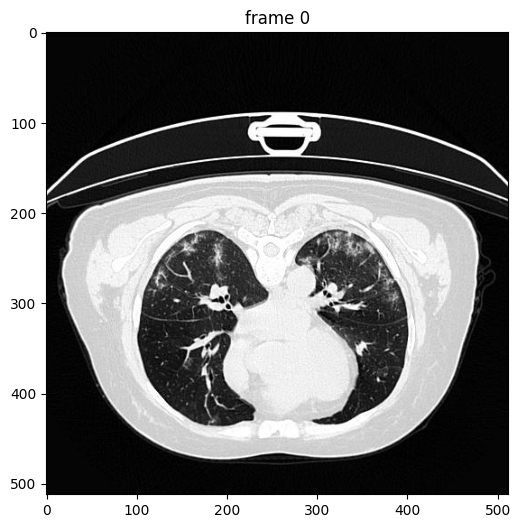

In [5]:
# `video_dir` a directory of JPEG frames with filenames like `<frame_index>.jpg`
video_dir = '../working_data/covid/sam2_videos/image_coronacases_001/half1'

# scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in ['.jpg', '.jpeg', '.JPG', '.JPEG']
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))

# take a look the first video frame
frame_idx = 0
plt.figure(figsize=(9, 6))
plt.title(f'frame {frame_idx}')
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))

In [6]:
inference_state = predictor.init_state(video_path=video_dir)

frame loading (JPEG): 100%|██████████| 150/150 [00:03<00:00, 39.31it/s]


In [7]:
# predictor.reset_state(inference_state)

In [8]:
from tools.image_slice import ImageSlice
from process_image import load_image, load_masks, load_image_slice, load_masks_slice

def get_image_slice(slice_number: int) -> ImageSlice:
    image_file_path = Path('../working_data/covid/image_coronacases_001.npz')
    masks_file_path = Path('../working_data/covid/masks_coronacases_001.npz')

    image = load_image(image_file_path=image_file_path)
    masks = load_masks(masks_file_path=masks_file_path)

    image_slice_points = load_image_slice(image=image, slice_number=slice_number)
    image_slice_labeled_points = load_masks_slice(masks=masks, slice_number=slice_number)

    return ImageSlice(
        points=image_slice_points,
        labeled_points=image_slice_labeled_points,
        apply_windowing=True,
        use_bounding_box=True,
        use_masks_contours=False)

image_slice = get_image_slice(slice_number=150)
point_coords = image_slice.get_point_coordinates()
point_labels = image_slice.centers_labels
bounding_box = image_slice.get_box()

/home/andy/miniconda3/envs/sam2/lib/python3.12/site-packages/sam2/sam2_video_predictor.py:873: UserWarning: /home/andy/miniconda3/envs/sam2/lib/python3.12/site-packages/sam2/_C.so: undefined symbol: _ZN3c1015SmallVectorBaseIjE8grow_podEPKvmm

Skipping the post-processing step due to the error above. You can still use SAM 2 and it's OK to ignore the error above, although some post-processing functionality may be limited (which doesn't affect the results in most cases; see https://github.com/facebookresearch/segment-anything-2/blob/main/INSTALL.md).
  pred_masks_gpu = fill_holes_in_mask_scores(


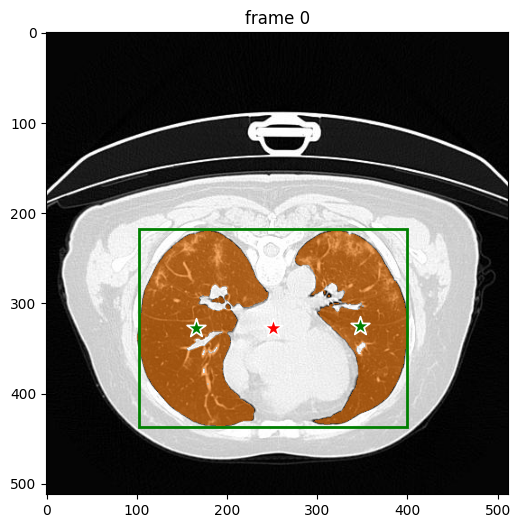

In [9]:
# check the example notebook. this produces a warning/error the first time it is run
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

# Let's add a 2nd positive click at (x, y) = (250, 220) to refine the mask
# sending all clicks (and their labels) to `add_new_points_or_box`
# points = np.array([[347, 325], [166, 327], [251, 327]], dtype=np.float32)
points = point_coords.astype(np.float32)
# for labels, `1` means positive click and `0` means negative click
# labels = np.array([1, 1, 0], np.int32)
labels = point_labels.astype(np.int32)
# box = np.array([102, 218, 400, 437], dtype=np.float32)
box = bounding_box.astype(np.float32)
_, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
    box=box
)

# show the results on the current (interacted) frame
plt.figure(figsize=(9, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_box(box, plt.gca())
show_points(points, labels, plt.gca())
show_mask((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

propagate in video: 100%|██████████| 150/150 [02:32<00:00,  1.01s/it]
/tmp/ipykernel_134686/4036860389.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))
/mnt/c/Users/andy/OneDrive - Universidade de Santiago de Compostela/Documents/i3lab/sam2/process_image.py:245: RuntimeWarning: invalid value encountered in divide
  jaccard = intersection.sum() / float(union.sum())
/mnt/c/Users/andy/OneDrive - Universidade de Santiago de Compostela/Documents/i3lab/sam2/process_image.py:246: RuntimeWarning: invalid value encountered in scalar divide
  dice = intersection.sum() * 2 / (original_mask_as_bool.sum() + predicted_mask.sum())


            slice     jaccard        dice
count  150.000000  101.000000  101.000000
mean    75.500000    0.908124    0.945242
std     43.445368    0.120757    0.108137
min      1.000000    0.000000    0.000000
25%     38.250000    0.902438    0.948717
50%     75.500000    0.927677    0.962482
75%    112.750000    0.960791    0.980004
max    150.000000    0.985866    0.992883


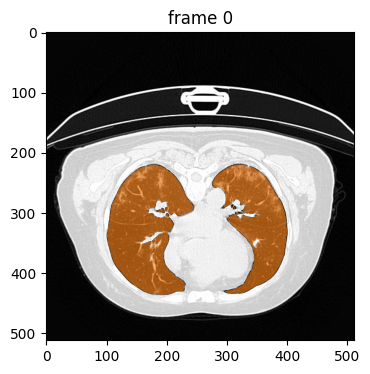

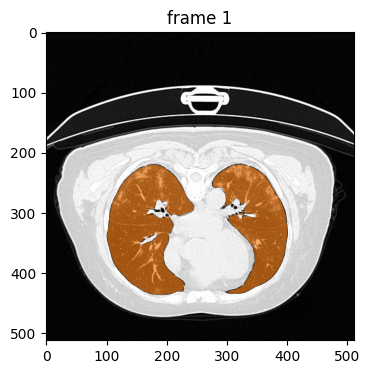

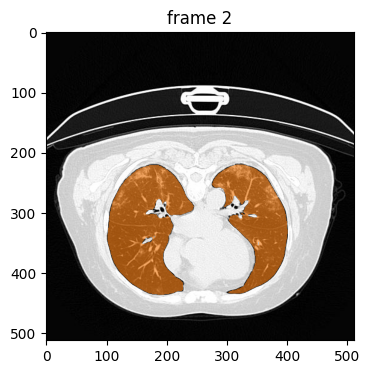

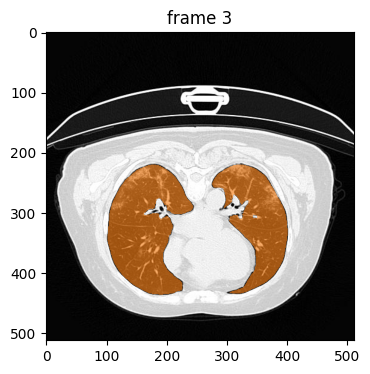

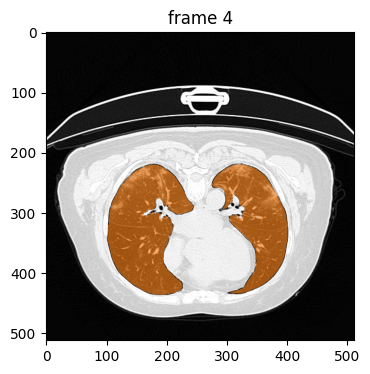

...

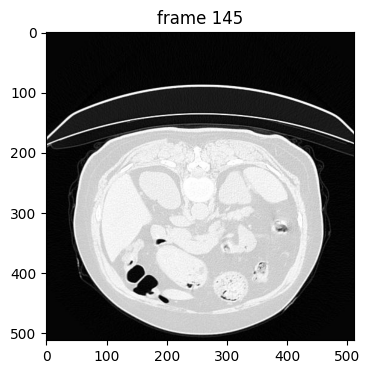

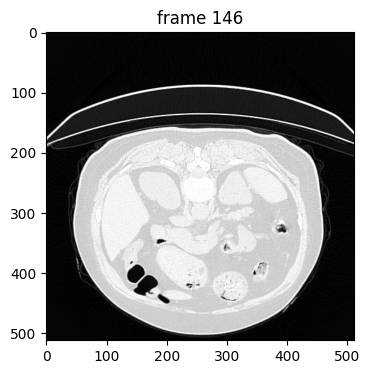

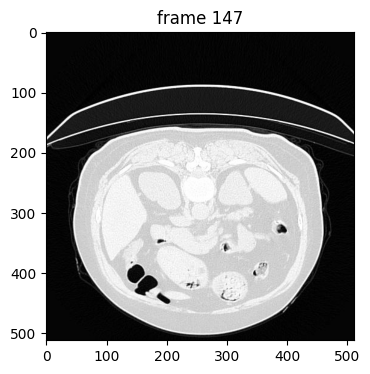

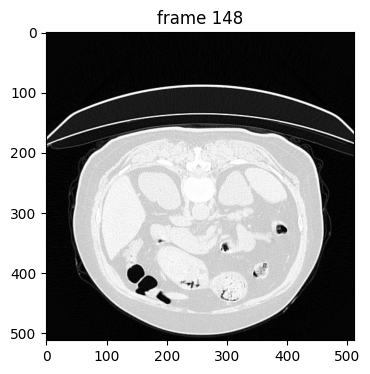

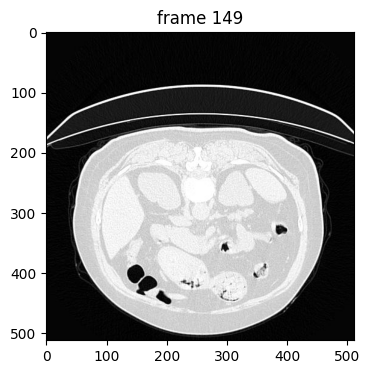

In [10]:
import pandas as pd
from process_image import compare_original_and_predicted_masks

# run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# render the segmentation results every few frames
vis_frame_stride = 1
plt.close("all")
results = []
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask(out_mask, plt.gca(), obj_id=out_obj_id)

        masks_file_path = Path('../working_data/covid/masks_coronacases_001.npz')
        masks = load_masks(masks_file_path=masks_file_path)
        slice_number = 150 - out_frame_idx
        image_slice_labeled_points = load_masks_slice(masks=masks, slice_number=slice_number)

        jaccard, dice = compare_original_and_predicted_masks(
            original_mask=image_slice_labeled_points, predicted_mask=out_mask)

        from csv_keys import *

        if image_slice_labeled_points.size > 1:
            result = {
                SliceNumberKey: slice_number,
                JaccardKey: jaccard,
                DiceKey: dice
            }
        else:
            result = {
                SliceNumberKey: slice_number,
                JaccardKey: None,
                DiceKey: None
            }
        results.append(result)

df_results = pd.DataFrame(results)
print(df_results.describe())
df_results.to_csv('../working_data/covid/sam2_videos/image_coronacases_001/half1/results.csv', index=False)
